## New York Taxi Trip Prediction Kaggle Problem

In [63]:
import pandas as pd
import numpy as np

In [64]:
df = pd.read_csv('taxifare.csv')
df.head()

,pickup_datetime,fare_amount,fare_class,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count
0,2010-04-19 08:17:56 UTC,6.5,0,-73.992365,40.730521,-73.975499,40.744746,1
1,2010-04-17 15:43:53 UTC,6.9,0,-73.990078,40.740558,-73.974232,40.744114,1
2,2010-04-17 11:23:26 UTC,10.1,1,-73.994149,40.751118,-73.960064,40.766235,2
3,2010-04-11 21:25:03 UTC,8.9,0,-73.990485,40.756422,-73.971205,40.748192,1
4,2010-04-17 02:19:01 UTC,19.7,1,-73.990976,40.734202,-73.905956,40.743115,1


In [65]:
df.shape

(120000, 8)

In [66]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 120000 entries, 0 to 119999
Data columns (total 8 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   pickup_datetime    120000 non-null  object 
 1   fare_amount        120000 non-null  float64
 2   fare_class         120000 non-null  int64  
 3   pickup_longitude   120000 non-null  float64
 4   pickup_latitude    120000 non-null  float64
 5   dropoff_longitude  120000 non-null  float64
 6   dropoff_latitude   120000 non-null  float64
 7   passenger_count    120000 non-null  int64  
dtypes: float64(5), int64(2), object(1)
memory usage: 7.3+ MB


In [67]:
df.isnull().values.any()

False

In [68]:
df.describe()

,fare_amount,fare_class,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count
count,120000.000000,120000.000000,120000.000000,120000.000000,120000.000000,120000.000000,120000.000000
mean,10.040326,0.333333,-73.976626,40.751443,-73.974501,40.751695,1.347167
std,7.500134,0.471406,0.031497,0.025821,0.032419,0.030279,0.759263
min,2.500000,0.000000,-74.465447,40.121653,-74.443323,40.164927,1.000000
25%,5.700000,0.000000,-73.992386,40.736594,-73.991478,40.735914,1.000000
50%,7.700000,0.000000,-73.982084,40.753661,-73.980411,40.754441,1.000000
75%,11.300000,1.000000,-73.968710,40.768020,-73.965500,40.768880,1.000000
max,49.900000,1.000000,-73.311845,40.981292,-73.496140,40.993498,5.000000


# Convert the 'pickup_datetime' into date and time
Initialy it in the UTC format, it has to convert it into the nyc format Coordinated Universal Time is 4 hours ahead of New York, NY, USA

In [69]:
import datetime
pd.to_datetime(df['pickup_datetime'])

0        2010-04-19 08:17:56+00:00
1        2010-04-17 15:43:53+00:00
2        2010-04-17 11:23:26+00:00
3        2010-04-11 21:25:03+00:00
4        2010-04-17 02:19:01+00:00
                    ...           
119995   2010-04-18 14:33:03+00:00
119996   2010-04-23 10:27:48+00:00
119997   2010-04-18 18:50:40+00:00
119998   2010-04-13 08:14:44+00:00
119999   2010-04-17 16:00:14+00:00
Name: pickup_datetime, Length: 120000, dtype: datetime64[ns, UTC]

In [70]:
df['pickup_datetime'] = pd.to_datetime(df['pickup_datetime']) - datetime.timedelta(hours=4)
df.head()

,pickup_datetime,fare_amount,fare_class,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count
0,2010-04-19 04:17:56+00:00,6.5,0,-73.992365,40.730521,-73.975499,40.744746,1
1,2010-04-17 11:43:53+00:00,6.9,0,-73.990078,40.740558,-73.974232,40.744114,1
2,2010-04-17 07:23:26+00:00,10.1,1,-73.994149,40.751118,-73.960064,40.766235,2
3,2010-04-11 17:25:03+00:00,8.9,0,-73.990485,40.756422,-73.971205,40.748192,1
4,2010-04-16 22:19:01+00:00,19.7,1,-73.990976,40.734202,-73.905956,40.743115,1


In [71]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 120000 entries, 0 to 119999
Data columns (total 8 columns):
 #   Column             Non-Null Count   Dtype              
---  ------             --------------   -----              
 0   pickup_datetime    120000 non-null  datetime64[ns, UTC]
 1   fare_amount        120000 non-null  float64            
 2   fare_class         120000 non-null  int64              
 3   pickup_longitude   120000 non-null  float64            
 4   pickup_latitude    120000 non-null  float64            
 5   dropoff_longitude  120000 non-null  float64            
 6   dropoff_latitude   120000 non-null  float64            
 7   passenger_count    120000 non-null  int64              
dtypes: datetime64[ns, UTC](1), float64(5), int64(2)
memory usage: 7.3 MB


Divide the "Pickup_datetime" feature into year, month, day, hour, minutes 

In [72]:
df['year'] = df['pickup_datetime'].dt.year
df['year']

0         2010
1         2010
2         2010
3         2010
4         2010
          ... 
119995    2010
119996    2010
119997    2010
119998    2010
119999    2010
Name: year, Length: 120000, dtype: int32

In [73]:
df['year'] = df['pickup_datetime'].dt.year
df['month'] = df['pickup_datetime'].dt.month
df['day'] = df['pickup_datetime'].dt.day
df['hours'] = df['pickup_datetime'].dt.hour
df['minutes'] = df['pickup_datetime'].dt.minute
df['second'] = df['pickup_datetime'].dt.second

In [74]:
df.shape

(120000, 14)

In [75]:
df.head()

,pickup_datetime,fare_amount,fare_class,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,year,month,day,hours,minutes,second
0,2010-04-19 04:17:56+00:00,6.5,0,-73.992365,40.730521,-73.975499,40.744746,1,2010,4,19,4,17,56
1,2010-04-17 11:43:53+00:00,6.9,0,-73.990078,40.740558,-73.974232,40.744114,1,2010,4,17,11,43,53
2,2010-04-17 07:23:26+00:00,10.1,1,-73.994149,40.751118,-73.960064,40.766235,2,2010,4,17,7,23,26
3,2010-04-11 17:25:03+00:00,8.9,0,-73.990485,40.756422,-73.971205,40.748192,1,2010,4,11,17,25,3
4,2010-04-16 22:19:01+00:00,19.7,1,-73.990976,40.734202,-73.905956,40.743115,1,2010,4,16,22,19,1


In [76]:
df['daynight'] = np.where(df['hours']<12,0,1)

In [77]:
df.head()

,pickup_datetime,fare_amount,fare_class,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,year,month,day,hours,minutes,second,daynight
0,2010-04-19 04:17:56+00:00,6.5,0,-73.992365,40.730521,-73.975499,40.744746,1,2010,4,19,4,17,56,0
1,2010-04-17 11:43:53+00:00,6.9,0,-73.990078,40.740558,-73.974232,40.744114,1,2010,4,17,11,43,53,0
2,2010-04-17 07:23:26+00:00,10.1,1,-73.994149,40.751118,-73.960064,40.766235,2,2010,4,17,7,23,26,0
3,2010-04-11 17:25:03+00:00,8.9,0,-73.990485,40.756422,-73.971205,40.748192,1,2010,4,11,17,25,3,1
4,2010-04-16 22:19:01+00:00,19.7,1,-73.990976,40.734202,-73.905956,40.743115,1,2010,4,16,22,19,1,1


In [78]:
df.drop('pickup_datetime',axis=1,inplace=True)

In [79]:
df.head()

,fare_amount,fare_class,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,year,month,day,hours,minutes,second,daynight
0,6.5,0,-73.992365,40.730521,-73.975499,40.744746,1,2010,4,19,4,17,56,0
1,6.9,0,-73.990078,40.740558,-73.974232,40.744114,1,2010,4,17,11,43,53,0
2,10.1,1,-73.994149,40.751118,-73.960064,40.766235,2,2010,4,17,7,23,26,0
3,8.9,0,-73.990485,40.756422,-73.971205,40.748192,1,2010,4,11,17,25,3,1
4,19.7,1,-73.990976,40.734202,-73.905956,40.743115,1,2010,4,16,22,19,1,1


In [80]:
df['fare_class'].unique()

array([0, 1], dtype=int64)

# Calculate distance between longitude and lattitude

In [81]:
# from sklearn.metrics.pairwise import haversine_distances
# from math import radians
# pickup_long = df['pickup_longitude']
# pickup_lat = df['pickup_latitude']
# dropoff_long = df['dropoff_longitude']
# dropoff_lat = df['dropoff_latitude']
# pickup_long.apply(radians)
# pickup_lat.apply(radians)
# dropoff_long.apply(radians)
# dropoff_lat.apply(radians)
# pickup_long = df['pickup_longitude'].iloc[0]
# pickup_lat = df['pickup_latitude'].iloc[0]
# dropoff_long = df['dropoff_longitude'].iloc[0]
# dropoff_lat = df['dropoff_latitude'].iloc[0]

In [82]:
# pickup = [[pickup_lat,pickup_long]]
# dropoff = [[dropoff_lat,dropoff_long]]
# result = haversine_distances(dropoff,pickup)
# result * 6371

In [83]:
# Calculate the distance
def haversine(df):
    lat1 = np.radians(df['pickup_latitude'])
    lat2 = np.radians(df['dropoff_latitude'])
    # based on the formula
    dlat = np.radians(df['dropoff_latitude']-df['pickup_latitude'])
    dlong = np.radians(df['dropoff_longitude']-df['pickup_longitude'])
    a = np.sin(dlat/2)**2 + np.cos(lat1)*np.cos(lat2) * np.sin(dlong/2)**2
    c = 2*np.arcsin(np.sqrt(a), np.sqrt(1-a))
    return c* 6371

In [84]:
df['total_dist'] = haversine(df)

In [85]:
df.head()

,fare_amount,fare_class,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,year,month,day,hours,minutes,second,daynight,total_dist
0,6.5,0,-73.992365,40.730521,-73.975499,40.744746,1,2010,4,19,4,17,56,0,2.126312
1,6.9,0,-73.990078,40.740558,-73.974232,40.744114,1,2010,4,17,11,43,53,0,1.392307
2,10.1,1,-73.994149,40.751118,-73.960064,40.766235,2,2010,4,17,7,23,26,0,3.326763
3,8.9,0,-73.990485,40.756422,-73.971205,40.748192,1,2010,4,11,17,25,3,1,1.864129
4,19.7,1,-73.990976,40.734202,-73.905956,40.743115,1,2010,4,16,22,19,1,1,7.231321


In [86]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 120000 entries, 0 to 119999
Data columns (total 15 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   fare_amount        120000 non-null  float64
 1   fare_class         120000 non-null  int64  
 2   pickup_longitude   120000 non-null  float64
 3   pickup_latitude    120000 non-null  float64
 4   dropoff_longitude  120000 non-null  float64
 5   dropoff_latitude   120000 non-null  float64
 6   passenger_count    120000 non-null  int64  
 7   year               120000 non-null  int32  
 8   month              120000 non-null  int32  
 9   day                120000 non-null  int32  
 10  hours              120000 non-null  int32  
 11  minutes            120000 non-null  int32  
 12  second             120000 non-null  int32  
 13  daynight           120000 non-null  int32  
 14  total_dist         120000 non-null  float64
dtypes: float64(6), int32(7), int64(2)
memory usage: 10.

In [87]:
df.drop(['pickup_longitude','pickup_latitude','dropoff_longitude','dropoff_latitude'],axis=1,inplace=True)

In [88]:
df.describe()

,fare_amount,fare_class,passenger_count,year,month,day,hours,minutes,second,daynight,total_dist
count,120000.000000,120000.000000,120000.000000,120000.0,120000.0,120000.000000,120000.000000,120000.000000,120000.000000,120000.000000,120000.000000
mean,10.040326,0.333333,1.347167,2010.0,4.0,17.701042,11.920042,29.614242,28.075067,0.531642,3.322160
std,7.500134,0.471406,0.759263,0.0,0.0,3.989551,5.964038,17.349243,18.097195,0.499000,3.337004
min,2.500000,0.000000,1.000000,2010.0,4.0,11.000000,0.000000,0.000000,0.000000,0.000000,0.010208
25%,5.700000,0.000000,1.000000,2010.0,4.0,14.000000,7.000000,15.000000,12.000000,0.000000,1.316428
50%,7.700000,0.000000,1.000000,2010.0,4.0,17.000000,12.000000,30.000000,28.000000,1.000000,2.237084
75%,11.300000,1.000000,1.000000,2010.0,4.0,21.000000,17.000000,45.000000,44.000000,1.000000,4.034564
max,49.900000,1.000000,5.000000,2010.0,4.0,24.000000,23.000000,59.000000,59.000000,1.000000,28.846365


In [124]:
df.head()
df.to_csv('taxifare_update1.csv')

## Storing the data in Mongodb

In [90]:
import json
records = json.loads(df.T.to_json()).values()

In [91]:
import pymongo
client = pymongo.MongoClient('mongodb://localhost:27017/')
db = client["newyork"]
col = db["fares"]

In [92]:
records

dict_values([{'fare_amount': 6.5, 'fare_class': 0.0, 'passenger_count': 1.0, 'year': 2010.0, 'month': 4.0, 'day': 19.0, 'hours': 4.0, 'minutes': 17.0, 'second': 56.0, 'daynight': 0.0, 'total_dist': 2.1263115857}, {'fare_amount': 6.9, 'fare_class': 0.0, 'passenger_count': 1.0, 'year': 2010.0, 'month': 4.0, 'day': 17.0, 'hours': 11.0, 'minutes': 43.0, 'second': 53.0, 'daynight': 0.0, 'total_dist': 1.3923068653}, {'fare_amount': 10.1, 'fare_class': 1.0, 'passenger_count': 2.0, 'year': 2010.0, 'month': 4.0, 'day': 17.0, 'hours': 7.0, 'minutes': 23.0, 'second': 26.0, 'daynight': 0.0, 'total_dist': 3.3267634407}, {'fare_amount': 8.9, 'fare_class': 0.0, 'passenger_count': 1.0, 'year': 2010.0, 'month': 4.0, 'day': 11.0, 'hours': 17.0, 'minutes': 25.0, 'second': 3.0, 'daynight': 1.0, 'total_dist': 1.8641292506}, {'fare_amount': 19.7, 'fare_class': 1.0, 'passenger_count': 1.0, 'year': 2010.0, 'month': 4.0, 'day': 16.0, 'hours': 22.0, 'minutes': 19.0, 'second': 1.0, 'daynight': 1.0, 'total_dist':

In [93]:
col.insert_many(records)

InsertManyResult([ObjectId('669ca39eea4bf8289be06462'), ObjectId('669ca39eea4bf8289be06463'), ObjectId('669ca39eea4bf8289be06464'), ObjectId('669ca39eea4bf8289be06465'), ObjectId('669ca39eea4bf8289be06466'), ObjectId('669ca39eea4bf8289be06467'), ObjectId('669ca39eea4bf8289be06468'), ObjectId('669ca39eea4bf8289be06469'), ObjectId('669ca39eea4bf8289be0646a'), ObjectId('669ca39eea4bf8289be0646b'), ObjectId('669ca39eea4bf8289be0646c'), ObjectId('669ca39eea4bf8289be0646d'), ObjectId('669ca39eea4bf8289be0646e'), ObjectId('669ca39eea4bf8289be0646f'), ObjectId('669ca39eea4bf8289be06470'), ObjectId('669ca39eea4bf8289be06471'), ObjectId('669ca39eea4bf8289be06472'), ObjectId('669ca39eea4bf8289be06473'), ObjectId('669ca39eea4bf8289be06474'), ObjectId('669ca39eea4bf8289be06475'), ObjectId('669ca39eea4bf8289be06476'), ObjectId('669ca39eea4bf8289be06477'), ObjectId('669ca39eea4bf8289be06478'), ObjectId('669ca39eea4bf8289be06479'), ObjectId('669ca39eea4bf8289be0647a'), ObjectId('669ca39eea4bf8289be064

# Train Test split

In [94]:
X= df[['day','passenger_count','fare_amount','year','hours','minutes','second','daynight','total_dist']]
Y = df['fare_class']

In [95]:
from sklearn.model_selection import train_test_split
x_train,x_test,y_train,y_test = train_test_split(X,Y,test_size=0.25,random_state=42)

In [96]:
# Scaling the data
from sklearn.preprocessing import StandardScaler
scalar = StandardScaler()
x_train = scalar.fit_transform(x_train)
x_test = scalar.transform(x_test)

In [97]:
from sklearn.linear_model import LogisticRegression
regression = LogisticRegression()
regression.fit(x_train,y_train)
y_pred = regression.predict(x_test)

In [98]:
from sklearn.metrics import accuracy_score
accuracy_score(y_test,y_pred)

0.9999333333333333

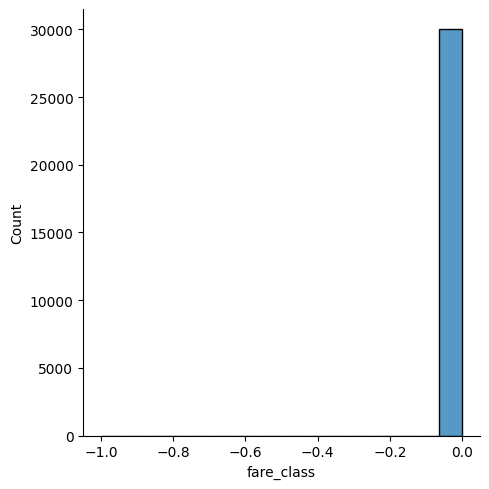

In [99]:
import seaborn as sns
sns.displot(y_test-y_pred)

# Regressin Model

In [100]:
x = df.iloc[:,1:]
y = df.iloc[:,0]


In [101]:
from sklearn.ensemble import ExtraTreesRegressor
model = ExtraTreesRegressor()
model.fit(x,y)

ExtraTreesRegressor()

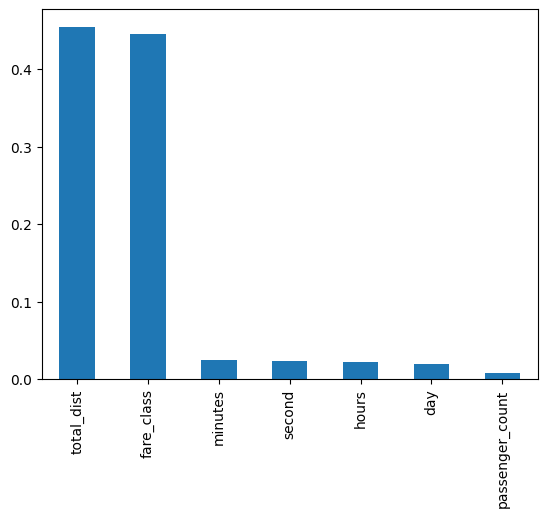

In [102]:
import matplotlib.pyplot as plt
feature_plot = pd.Series(model.feature_importances_,index=x.columns)
feature_plot.nlargest(7).plot(kind='bar')
plt.show()

In [103]:
x

,fare_class,passenger_count,year,month,day,hours,minutes,second,daynight,total_dist
0,0,1,2010,4,19,4,17,56,0,2.126312
1,0,1,2010,4,17,11,43,53,0,1.392307
2,1,2,2010,4,17,7,23,26,0,3.326763
3,0,1,2010,4,11,17,25,3,1,1.864129
4,1,1,2010,4,16,22,19,1,1,7.231321
...,...,...,...,...,...,...,...,...,...,...
119995,1,1,2010,4,18,10,33,3,0,5.751348
119996,1,1,2010,4,23,6,27,48,0,5.767444
119997,1,3,2010,4,18,14,50,40,1,5.052523
119998,0,1,2010,4,13,4,14,44,0,1.208923


In [104]:
y

0          6.5
1          6.9
2         10.1
3          8.9
4         19.7
          ... 
119995    15.3
119996    15.3
119997    12.5
119998     4.9
119999     5.3
Name: fare_amount, Length: 120000, dtype: float64

In [105]:
x_train,x_test,y_train,y_test = train_test_split(x,y,train_size=0.3,random_state=42)
import xgboost

In [106]:
regressor = xgboost.XGBRegressor()
regressor.fit(x_train,y_train)
y_pred = regressor.predict(x_test)

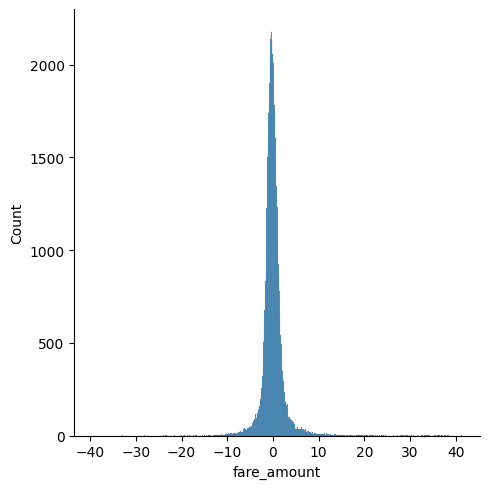

In [107]:
import seaborn as sns
sns.displot(y_test-y_pred,kind='hist')

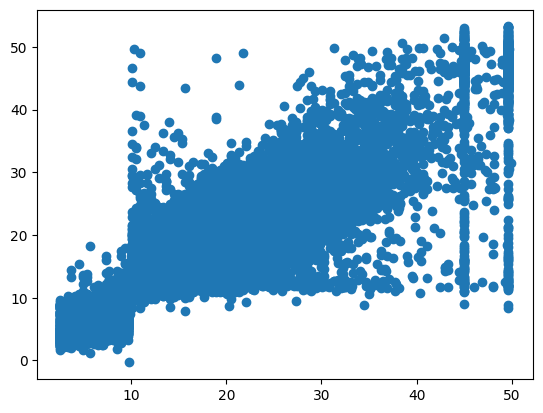

In [108]:
plt.scatter(y_test,y_pred)

In [109]:
from sklearn.metrics import r2_score,mean_absolute_error,mean_squared_error,root_mean_squared_error
print("r2",np.sqrt(r2_score(y_test,y_pred)))
print("MAE", mean_absolute_error(y_test,y_pred))
print("MSE",mean_squared_error(y_test,y_pred))
print('RMSE',np.sqrt(root_mean_squared_error(y_test,y_pred)))

r2 0.9325408886721105
MAE 1.4613525169460122
MSE 7.282308279375008
RMSE 1.6427340720189938


# Hyper Parameter

In [110]:
from sklearn.model_selection import RandomizedSearchCV
n_estimator = [int(x) for x in np.linspace(start=100,stop=1200,num=12)]
n_estimator

[100, 200, 300, 400, 500, 600, 700, 800, 900, 1000, 1100, 1200]

In [111]:
#no. of trees in xgboost
n_estimator = [int(x) for x in np.linspace(start=100,stop=1200,num=12)]
# various learning rate parameters
learning_rate = ['0.05','0.01','0.2','0.3','0.5']
# Maximum number of lavels in trees
max_depth = [int(x) for x in np.linspace(5,30,num=6)]
# subsamples parameters value
sub_sample = [0.7,0.6,0.8]
# Minimum child weight parameter
min_child_weight = [3,4,5,6,7]

In [112]:
# Create random grid
random_grid = {"n_estimator":n_estimator,'learning_rate':learning_rate,'max_depth':max_depth,'sub_sample':sub_sample,'min_child_weight':min_child_weight}
print(random_grid)

{'n_estimator': [100, 200, 300, 400, 500, 600, 700, 800, 900, 1000, 1100, 1200], 'learning_rate': ['0.05', '0.01', '0.2', '0.3', '0.5'], 'max_depth': [5, 10, 15, 20, 25, 30], 'sub_sample': [0.7, 0.6, 0.8], 'min_child_weight': [3, 4, 5, 6, 7]}


In [113]:
# used random grid to search for best parameter
# forst create a base model to tune
regressor = xgboost.XGBRegressor()

In [114]:
# Random search of parameters using 3 fold cross validation
xg_random = RandomizedSearchCV(estimator=regressor,param_distributions=random_grid,scoring='neg_mean_squared_error',n_iter=5,cv=5,verbose=2,random_state=42,n_jobs=-1)

In [115]:
xg_random.fit(x_train,y_train)

Fitting 5 folds for each of 5 candidates, totalling 25 fits


c:\Users\hp\AppData\Local\Programs\Python\Python312\Lib\site-packages\xgboost\core.py:158: UserWarning: [11:30:09] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-06abd128ca6c1688d-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "n_estimator", "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


RandomizedSearchCV(cv=5,
                   estimator=XGBRegressor(base_score=None, booster=None,
                                          callbacks=None,
                                          colsample_bylevel=None,
                                          colsample_bynode=None,
                                          colsample_bytree=None, device=None,
                                          early_stopping_rounds=None,
                                          enable_categorical=False,
                                          eval_metric=None, feature_types=None,
                                          gamma=None, grow_policy=None,
                                          importance_type=None,
                                          interaction_constraints=None,
                                          learning_rate=...
                                          num_parallel_tree=None,
                                          random_state=None, ...),
                   n_iter=5, n_jobs=-1,
                   param_distributions={'learning_rate': ['0.05', '0.01', '0.2',
                                                          '0.3', '0.5'],
                                        'max_depth': [5, 10, 15, 20, 25, 30],
                                        'min_child_weight': [3, 4, 5, 6, 7],
                                        'n_estimator': [100, 200, 300, 400, 500,
                                                        600, 700, 800, 900,
                                                        1000, 1100, 1200],
                                        'sub_sample': [0.7, 0.6, 0.8]},
                   random_state=42, scoring='neg_mean_squared_error',
                   verbose=2)

In [116]:
xg_random.best_params_

{'sub_sample': 0.8,
 'n_estimator': 1100,
 'min_child_weight': 6,
 'max_depth': 25,
 'learning_rate': '0.05'}

In [117]:
xg_random.best_score_

-8.172130792507401

In [118]:
xg_random.best_estimator_

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate='0.05', max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=25, max_leaves=None,
             min_child_weight=6, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimator=1100, n_estimators=None,
             n_jobs=None, num_parallel_tree=None, ...)

In [119]:
y_pred = xg_random.predict(x_test)

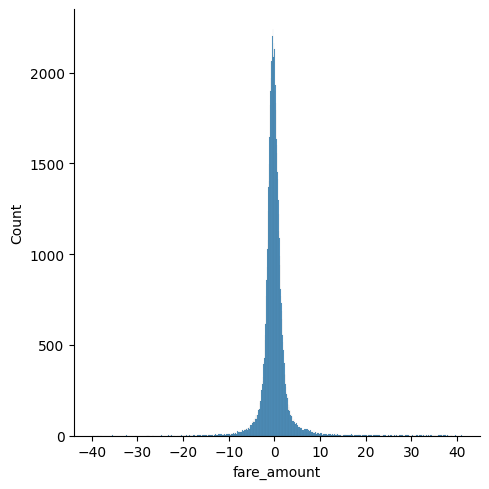

In [120]:
sns.displot(y_test-y_pred)

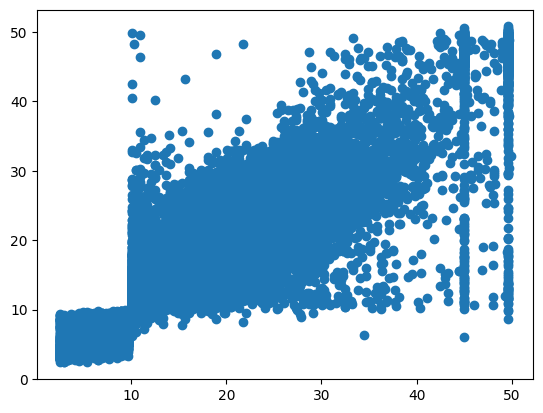

In [121]:
plt.scatter(y_test,y_pred)

In [122]:
from sklearn.metrics import r2_score,mean_absolute_error,mean_squared_error,root_mean_squared_error
print("r2",np.sqrt(r2_score(y_test,y_pred)))
print("MAE", mean_absolute_error(y_test,y_pred))
print("MSE",mean_squared_error(y_test,y_pred))
print('RMSE',np.sqrt(root_mean_squared_error(y_test,y_pred)))

r2 0.92887945790878
MAE 1.5199789028894335
MSE 7.663018937770253
RMSE 1.6637956124988396
